In [2]:
library(tidyverse)
library(lubridate)
library(ggplot2)
library(tidyr)
library(dplyr)

In [3]:
options(warn = -1)

## Read the Input data

In [4]:
confirmedraw = read.csv("time_series_covid19_confirmed_global.csv")

deathsraw= read.csv("time_series_covid19_deaths_global.csv")

recoveredraw = read.csv("time_series_covid19_recovered_global.csv")

In [5]:
countryToContinent = read.csv("countryToContinent.csv")

countryToContinent$Continent = as.character(countryToContinent$Continent)
countryToContinent$Country = as.character(countryToContinent$Country)

In [6]:
head(confirmedraw)

,Province.State,Country.Region,Lat,Long,X1.22.2020,X1.23.2020,X1.24.2020,X1.25.2020,X1.26.2020,X1.27.2020,⋯,X10.21.2022,X10.22.2022,X10.23.2022,X10.24.2022,X10.25.2022,X10.26.2022,X10.27.2022,X10.28.2022,X10.29.2022,X10.30.2022
,<chr>,<chr>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,,Afghanistan,33.93911,67.70995,0,0,0,0,0,0,⋯,201949,202026,202108,202199,202347,202509,202608,202756,202834,202966
2,,Albania,41.15330,20.16830,0,0,0,0,0,0,⋯,332739,332754,332772,332776,332816,332847,332889,332911,332949,332966
3,,Algeria,28.03390,1.65960,0,0,0,0,0,0,⋯,270771,270771,270783,270788,270800,270810,270817,270826,270829,270836
4,,Andorra,42.50630,1.52180,0,0,0,0,0,0,⋯,46449,46449,46449,46449,46449,46535,46535,46535,46535,46535
5,,Angola,-11.20270,17.87390,0,0,0,0,0,0,⋯,103131,103131,103131,103131,103131,103131,103131,103131,103131,103131
6,,Antarctica,-71.94990,23.34700,0,0,0,0,0,0,⋯,11,11,11,11,11,11,11,11,11,11


In [7]:
print(dim(confirmedraw))

print(dim(deathsraw))

print(dim(recoveredraw))

[1]  289 1017
[1]  289 1001
[1]  274 1001


In [8]:
formatTheData = function(data,colName) {
    
    data <- data %>% gather(key="date", value= col, -c(Country.Region, Province.State, Lat, Long)) %>%
        group_by(Province.State,Country.Region, date) %>% summarize(col=sum(col))
    
    data$date <- data$date %>% sub("X", "", .) %>% as.Date("%m.%d.%y")
    
    data <- data %>% arrange(date)
    
    data = data %>% group_by(Country.Region,date) %>% summarise(col=sum(col)) 
    
    
    colnames(data)[3] <- colName
    
    data = merge(countryToContinent,data,  by.y = "Country.Region", by.x = "Country")
    
    data = select(data, -c('X'))
    
    return(data)
}

In [9]:
case.conf = formatTheData(confirmedraw,"conf")
case.death = formatTheData(deathsraw,"death")
case.recov = formatTheData(recoveredraw,"recov")

`summarise()` has grouped output by 'Province.State', 'Country.Region'. You can override using the `.groups` argument.
`summarise()` has grouped output by 'Country.Region'. You can override using the `.groups` argument.
`summarise()` has grouped output by 'Province.State', 'Country.Region'. You can override using the `.groups` argument.
`summarise()` has grouped output by 'Country.Region'. You can override using the `.groups` argument.
`summarise()` has grouped output by 'Province.State', 'Country.Region'. You can override using the `.groups` argument.
`summarise()` has grouped output by 'Country.Region'. You can override using the `.groups` argument.


## Merge All data Frames

In [10]:
country <- full_join(case.conf, case.death) %>% full_join(case.recov)

Joining, by = c("Country", "Continent", "date")
Joining, by = c("Country", "Continent", "date")


In [11]:
head(country)

,Country,Continent,date,conf,death,recov
,<chr>,<chr>,<date>,<int>,<int>,<int>
1,Afghanistan,Asia,2020-08-01,370227,15775,108095
2,Afghanistan,Asia,2020-04-12,236054,10223,52037
3,Afghanistan,Asia,2020-03-18,233053,10113,49665
4,Afghanistan,Asia,2020-03-14,232408,10102,49477
5,Afghanistan,Asia,2020-07-20,362047,15190,106327
6,Afghanistan,Asia,2020-05-23,255396,10715,57075


In [12]:
country$Active = country$conf - country$death - country$recov

country <- country %>% arrange(date)

head(country)

,Country,Continent,date,conf,death,recov,Active
,<chr>,<chr>,<date>,<int>,<int>,<int>,<int>
1,Afghanistan,Asia,2020-01-01,210620,9557,41727,159336
2,Albania,Europe,2020-01-01,268540,4398,33634,230508
3,Algeria,Africa,2020-01-01,318715,9046,67395,242274
4,Andorra,Europe,2020-01-01,31857,224,7463,24170
5,Angola,Africa,2020-01-01,99966,2177,11146,86643
6,Antigua and Barbuda,North America,2020-01-01,4442,124,148,4170


In [13]:
unique(country$Continent)

[1] "Asia"          "Europe"        "Africa"        "North America"
[5] "South America" "Oceania"

In [14]:
head(country)

,Country,Continent,date,conf,death,recov,Active
,<chr>,<chr>,<date>,<int>,<int>,<int>,<int>
1,Afghanistan,Asia,2020-01-01,210620,9557,41727,159336
2,Albania,Europe,2020-01-01,268540,4398,33634,230508
3,Algeria,Africa,2020-01-01,318715,9046,67395,242274
4,Andorra,Europe,2020-01-01,31857,224,7463,24170
5,Angola,Africa,2020-01-01,99966,2177,11146,86643
6,Antigua and Barbuda,North America,2020-01-01,4442,124,148,4170


In [15]:
ggplot_cases_time = country %>% 
  ggplot(aes(x = date,
             y = conf,
             color = Continent,
             # the group aesthetic tells ggplot which
             ## variable connects the dots that build each line,
             ##in this case it's the location/country variable
             group = Continent))+
              geom_line()+
              theme_minimal()+
              scale_color_brewer(palette = "Paired")+
              ylab("Daily number of cases")+
              xlab('Date')+
              labs(color = "Continent")+
              ggtitle("Daily number of cases over time")

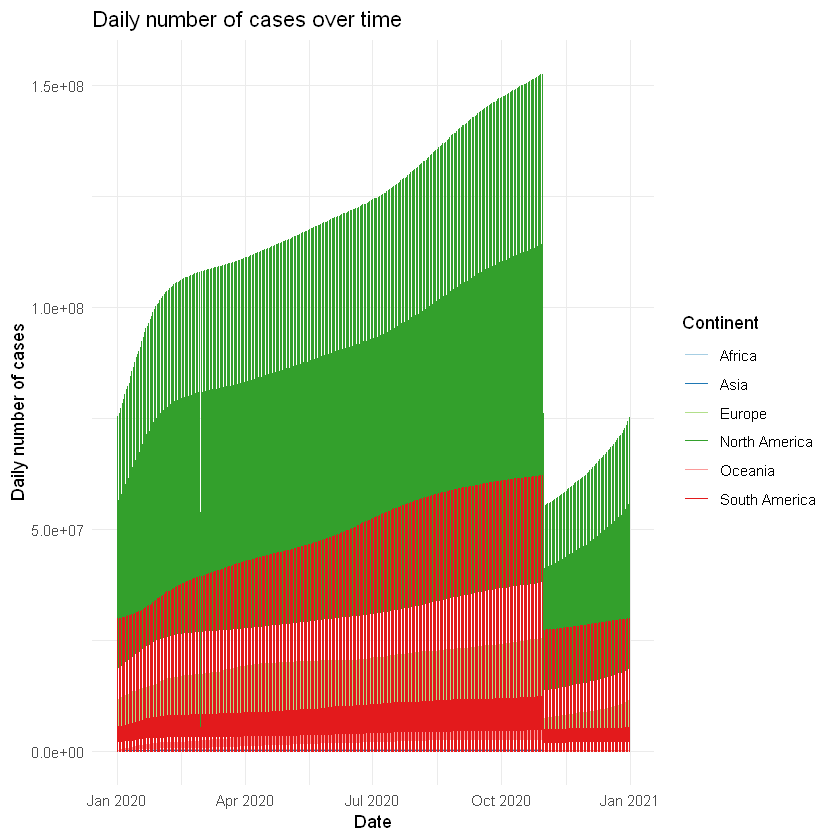

In [16]:
ggplot_cases_time

In [17]:
country.wise = country %>% group_by(Continent, Country) %>% distinct() %>%  
            group_by(Continent, Country) %>%
            summarise(Confirmed = sum(conf),
            Deaths = sum(death), #using max because data is cumulative
            Recovered = sum(recov),
            Active = sum(Active))  %>% arrange(-Confirmed)

head(country.wise)

`summarise()` has grouped output by 'Continent'. You can override using the `.groups` argument.


Continent,Country,Confirmed,Deaths,Recovered,Active
<chr>,<chr>,<dbl>,<int>,<dbl>,<dbl>
North America,US,40710695573,554358045,496971828,39659365700
Asia,India,23322917242,287470863,4859387857,18176058522
South America,Brazil,16484963800,386985155,3412350387,12685628258
Europe,France,11037805105,89729416,96506536,10851569153
Europe,United Kingdom,8947210561,129111471,3447793,8814651297
Europe,Germany,8877760692,72615767,695248246,8109896679


In [18]:
continent.wise = country %>%
  group_by(Continent) %>%
  summarise(Confirmed = sum(conf),
            Deaths = sum(death), #using max because data is cumulative
            Recovered = sum(recov),
            Active = sum(Active)) %>% arrange(-Active)

head(continent.wise)

Continent,Confirmed,Deaths,Recovered,Active
<chr>,<dbl>,<int>,<dbl>,<dbl>
Europe,69516084817,821656020,4128921334,64565507463
Asia,64185660907,703153807,9120434879,54362072221
North America,48031111110,808809417,1610942101,45611359592
South America,29781517872,758204115,5940776532,23082537225
Africa,5911215252,133826307,1059028452,4718360493
Oceania,2459123018,3999957,11650490,2443472571


In [185]:
df.plotly = country.wise

df.plotly$Continent = ifelse(is.na(df.plotly$Continent), "Other", df.plotly$Continent)

conts = df.plotly %>% group_by(Continent) %>% summarise(Deaths = sum(Deaths),
                                                        Confirmed = sum(Confirmed),
                                                        Recovered = sum(Recovered),
                                                        Active = sum(Active)) %>%
mutate(parent = "World") %>% rename(labels = Continent)

In [188]:
head(df.plotly)

Continent,Country,Confirmed,Deaths,Recovered,Active
<chr>,<chr>,<dbl>,<int>,<dbl>,<dbl>
North America,US,40710695573,554358045,496971828,39659365700
Asia,India,23322917242,287470863,4859387857,18176058522
South America,Brazil,16484963800,386985155,3412350387,12685628258
Europe,France,11037805105,89729416,96506536,10851569153
Europe,United Kingdom,8947210561,129111471,3447793,8814651297
Europe,Germany,8877760692,72615767,695248246,8109896679


In [190]:
countrs = df.plotly %>% group_by(Country) %>% 
        summarise(Deaths = sum(Deaths),
                  Confirmed = sum(Confirmed),
                  Recovered = sum(Recovered),
                  Active = sum(Active), 
                  parent = unique(Continent)) %>%  rename(labels = Country)

In [193]:
world = data.frame(labels = "World", Deaths = sum(conts$Deaths),
                   Confirmed = sum(conts$Confirmed), Recovered = sum(df.plotly$Recovered),
                   Active = sum(conts$Active), parent = "")


In [194]:
df.plotly = rbind(conts, countrs, world)

In [201]:
toPlot = df.plotly

In [202]:
library(plotly)

In [205]:
## Number of deaths
deads <- plot_ly( type="treemap",
  values= toPlot$Deaths,
  labels = toPlot$labels,
  parents= toPlot$parent,
  hoverinfo="label+value+percent parent+percent root"
) %>% plotly_build()

In [204]:
deads

HTML widgets cannot be represented in plain text (need html)

In [207]:
## Number of confirmed
conf <- plot_ly(
  type="treemap",
  values=toPlot$Confirmed,
  labels = toPlot$labels,
  parents= toPlot$parent,
  hoverinfo="label+value+percent parent+percent root"
) %>% plotly_build()


conf

HTML widgets cannot be represented in plain text (need html)

In [208]:
## Number of recovered
rec <- plot_ly(
  type="treemap",
  values=toPlot$Recovered,
  labels = toPlot$labels,
  parents= toPlot$parent,
  hoverinfo="label+value+percent parent+percent root"
  #domain=list(column=0)
) %>% plotly_build()

rec

HTML widgets cannot be represented in plain text (need html)

In [210]:
## Case-Fatality Rate by Country
deaths_conf <- plot_ly(
  type="treemap",
  values=round(toPlot$Deaths/toPlot$Confirmed,4)*100,
  labels = toPlot$labels,
  parents= toPlot$parent,
  hoverinfo="label+value+percent",
  hovertext = "Potato"
  #domain=list(column=0)
) %>% plotly_build()

deaths_conf

HTML widgets cannot be represented in plain text (need html)

## Look for NA values

In [127]:
sum(is.na(country))

[1] 0

In [134]:
today = case.death %>% select(-c(Country, Continent))
yesterday = lag(case.death %>% select(-c(Country, Continent)))
deaths.per.day = case.death %>% select(Country, Continent)
deaths.per.day = cbind(deaths.per.day, (today-yesterday)[-1])

In [136]:
today = case.conf %>% select(-c(Country, Continent))
yesterday = lag(case.conf %>% select(-c(Country, Continent)))
confirmed.per.day = case.conf %>% select(Country, Continent)
confirmed.per.day = cbind(confirmed.per.day, (today-yesterday)[-1])

In [138]:
today = case.recov %>% select(-c(Country, Continent))
yesterday = lag(case.recov %>% select(-c(Country, Continent)))
recovered.per.day = case.recov %>% select(Country, Continent)
recovered.per.day = cbind(recovered.per.day, (today-yesterday)[-1])


In [139]:
deaths.per.day = deaths.per.day %>% pivot_longer(-c(Country,Continent), names_to = "Date", values_to = "Amount") %>% mutate(Metric = "Deaths")
confirmed.per.day = confirmed.per.day %>% pivot_longer(-c(Country,Continent), names_to = "Date", values_to = "Amount") %>% mutate(Metric = "Confirmed")
recovered.per.day = recovered.per.day %>% pivot_longer(-c(Country,Continent), names_to = "Date", values_to = "Amount") %>% mutate(Metric = "Recovered")

In [142]:
all.per.day = rbind(deaths.per.day, confirmed.per.day, recovered.per.day)

In [145]:
saveRDS(all.per.day, "ProcessedData/allPerDay.rds")

In [31]:
data = confirmedraw

In [32]:
data <- data %>% gather(key="date", value= col, -c(Country.Region, Province.State, Lat, Long)) %>%
        group_by(Province.State,Country.Region, date) %>% summarize(col=sum(col))

head(data)

`summarise()` has grouped output by 'Province.State', 'Country.Region'. You can override using the `.groups` argument.


Province.State,Country.Region,date,col
<chr>,<chr>,<chr>,<int>
,Afghanistan,X1.1.2021,52513
,Afghanistan,X1.1.2022,158107
,Afghanistan,X1.10.2021,53489
,Afghanistan,X1.10.2022,158394
,Afghanistan,X1.11.2021,53538
,Afghanistan,X1.11.2022,158471


In [33]:
data$date <- data$date %>% sub("X", "", .) %>% as.Date("%m.%d.%y")

In [34]:
head(data)

Province.State,Country.Region,date,col
<chr>,<chr>,<date>,<int>
,Afghanistan,2020-01-01,52513
,Afghanistan,2020-01-01,158107
,Afghanistan,2020-01-10,53489
,Afghanistan,2020-01-10,158394
,Afghanistan,2020-01-11,53538
,Afghanistan,2020-01-11,158471


In [35]:
data <- data %>% arrange(date)

head(data)

Province.State,Country.Region,date,col
<chr>,<chr>,<date>,<int>
,Afghanistan,2020-01-01,52513
,Afghanistan,2020-01-01,158107
,Albania,2020-01-01,58316
,Albania,2020-01-01,210224
,Algeria,2020-01-01,99897
,Algeria,2020-01-01,218818


In [36]:
data = data %>% group_by(Country.Region,date) %>% summarise(col=sum(col)) 

head(data)

`summarise()` has grouped output by 'Country.Region'. You can override using the `.groups` argument.


Country.Region,date,col
<chr>,<date>,<int>
Afghanistan,2020-01-01,210620
Afghanistan,2020-01-02,210775
Afghanistan,2020-01-03,210892
Afghanistan,2020-01-04,211114
Afghanistan,2020-01-05,211256
Afghanistan,2020-01-06,211380


`summarise()` has grouped output by 'Province.State', 'Country.Region'. You can override using the `.groups` argument.


ERROR: [1m[33mError[39m in [1m[1m`summarise()`:[22m
[1m[22m[33m![39m Problem while computing `col = sum(confirmed)`.
[36mℹ[39m The error occurred in group 1: Country.Region = "Afghanistan", date = 2020-01-01.
[1mCaused by error in [1m[1m`FUN()`:[22m
[33m![39m only defined on a data frame with all numeric-alike variables


In [ ]:
head(data)

## Get the confirmed cases data

In [13]:
confirmed <- confirmedraw %>% 
             gather(key="date", value="confirmed", -c(Country.Region, Province.State, Lat, Long)) %>% 
             group_by(Province.State,Country.Region, date) %>% summarize(confirmed=sum(confirmed))

`summarise()` has grouped output by 'Province.State', 'Country.Region'. You can override using the `.groups` argument.


In [14]:
head(confirmed)

Province.State,Country.Region,date,confirmed
<chr>,<chr>,<chr>,<int>
,Afghanistan,X1.1.2021,52513
,Afghanistan,X1.1.2022,158107
,Afghanistan,X1.10.2021,53489
,Afghanistan,X1.10.2022,158394
,Afghanistan,X1.11.2021,53538
,Afghanistan,X1.11.2022,158471


In [ ]:
# Fix date variable and convert from character to date
confirmed$date <- confirmed$date %>% sub("X", "", .) %>% as.Date("%m.%d.%y")

confirmed <- confirmed %>% arrange(date)

confirmed = confirmed %>% group_by(Country.Region,date) %>% summarise(conf=sum(confirmed)) 

In [ ]:
head(confirmed)

## Get the deaths cases data

In [ ]:
deaths <- deathsraw %>% 
          gather(key="date", value="deaths", -c(Country.Region, Province.State, Lat, Long)) %>% 
          group_by(Country.Region, date) %>% summarize(deaths=sum(deaths))

In [ ]:
# Fix date variable and convert from character to date
deaths$date <- deaths$date %>% sub("X", "", .) %>% as.Date("%m.%d.%y")

deaths <- deaths %>% arrange(date)

deaths = deaths %>% group_by(Country.Region,date) %>% summarise(death=sum(deaths)) 

In [ ]:
head(deaths)

## Get the recovered cases data

In [ ]:
recovered <- recoveredraw %>% 
             gather(key="date", value="recovered", -c(Country.Region, Province.State, Lat, Long)) %>% 
             group_by(Country.Region, date) %>% summarize(recovered=sum(recovered))

In [ ]:
# Fix date variable and convert from character to date
recovered$date <- recovered$date %>% sub("X", "", .) %>% as.Date("%m.%d.%y")

recovered <- recovered %>% arrange(date)

recovered = recovered %>% group_by(Country.Region,date) %>% summarise(recov=sum(recovered)) 

In [ ]:
head(recovered)

## Combine All Three captured info

In [ ]:
# Final data: combine all three
country <- full_join(confirmed, deaths) %>% full_join(recovered)


In [ ]:
head(country)

In [ ]:
countryToContinent = read.csv('countryToContinent.csv')

In [ ]:
countryToContinent$Continent = as.character(countryToContinent$Continent)
countryToContinent$Country = as.character(countryToContinent$Country)

In [ ]:
#country = merge(countryToContinent,country,  by.y = "Country.Region", by.x = "Country")

In [ ]:
head(country)

## View sample data

In [ ]:
dim(country)

# Get days info from Day 1

In [ ]:
country = country %>% group_by(Country.Region) %>% mutate(days = date - first(date) + 1)

## Day Confirmed Cases 

In [ ]:
ggplot(country, aes(x=days, y=conf)) + geom_line() +
  theme_classic() +
  labs(title = "Covid-19 Global Confirmed Cases", x= "Days", y= "Daily confirmed cases") +
  theme(plot.title = element_text(hjust = 0.5))


# Cumulative Sum from day 1

In [ ]:
# Cumulative count of confirmed COVID cases and COVID deaths by country.

In [ ]:
country <- country %>% group_by(Country.Region) %>% mutate(cumconfirmed=cumsum(conf))

head(country)

## Aggregate at world level date wise

In [ ]:
world <- country %>% 
         group_by(date) %>% 
         summarize(confirmed=sum(conf), cumconfirmed=sum(cumconfirmed), deaths=sum(death), recovered=sum(recov)) %>% 
         mutate(days = date - first(date) + 1)

In [ ]:
head(world)

## Aggregate at world level county wise

In [ ]:
world <- country %>% 
         group_by(Country.Region) %>% 
         summarize(confirmed=sum(conf), cumconfirmed=sum(cumconfirmed), deaths=sum(death), recovered=sum(recov),date = date)

In [ ]:
head(world)

In [ ]:
# SUMMARY STATISTICS

In [ ]:
head(country)

# Top 10 Confirmed cases Country wise

In [ ]:
max_confimed =  country %>% group_by(Country.Region) %>% summarise(max_confirmed=max(conf),
                                                                   min_confirmed=min(conf),
                                                                   mean_confirmed = mean(conf),
                                                                   max_death = max(death),
                                                                   min_death=min(death),
                                                                   mean_death = mean(death),
                                                                   max_recov = max(recov),
                                                                   min_recov=min(recov),
                                                                   mean_recov = mean(recov))

max_confimed_top10 = max_confimed[order(max_confimed$max_confirmed, decreasing = TRUE),][1:10,]

max_confimed_top10

In [ ]:
cases_new <- max_confimed_top10 %>% 
  select(Country.Region, max_confirmed, max_death) %>%
  rename(State = Country.Region)

cases_new$State <- factor(cases_new$State)

ggplot(data = cases_new, mapping = aes(x = reorder(State, max_confirmed), 
                                      y = max_confirmed,
                                      fill = max_death)) + 
    geom_bar(stat = "identity", position = "stack") +
    xlab("State") +
    ylab("Confirmed Cases") +
    ggtitle("Confirmed Cases by State") +
    coord_flip()

In [ ]:
g = ggplot(max_confimed_top10,aes(x= max_confimed_top10$'Country.Region',
                                  y = max_confimed_top10$'mean_confirmed',
                                  fill= max_confimed_top10$'Country.Region'))

g + theme(axis.text.x = element_text(angle = 90)) + 
geom_bar(stat = "identity") + 
ylab("Confirmed") + 
ggtitle("Max Confirmed Cases")

In [ ]:
g = ggplot(max_confimed_top10,aes(x= max_confimed_top10$'Country.Region',
                                  y = max_confimed_top10$'mean_confirmed',
                                  fill= max_confimed_top10$'Country.Region'))

g + theme(axis.text.x = element_text(angle = 90)) + 
geom_bar(stat = "identity") + 
ylab("Confirmed") + 
ggtitle("Max Confirmed Cases")

## Daily Confirmed Cases

In [ ]:
ggplot(country, aes(x=date, y=conf)) +  
      geom_bar(stat="identity", width=0.1) + 
      theme() +
      labs(title = "Covid-19 Global Confirmed Cases", x= "date", y= "Daily confirmed cases") +
      theme(plot.title = element_text(hjust = 1))

## Daily Death Cases

In [ ]:
ggplot(country, aes(x=date, y=death)) +  
      geom_bar(stat="identity", width=0.1) + 
      theme() +
      labs(title = "Covid-19 Global Death Cases", x= "date", y= "Daily Death cases") +
      theme(plot.title = element_text(hjust = 1))

## Daily Recovered Cases

In [ ]:
ggplot(country, aes(x=date, y=recov)) +  
      geom_bar(stat="identity", width=0.1) + 
      theme() +
      labs(title = "Covid-19 Global Recovered Cases", x= "date", y= "Daily Recovered cases") +
      theme(plot.title = element_text(hjust = 1))

In [ ]:
head(country)

In [ ]:
countryselection <- country %>% filter(Country.Region==c("US", "Italy", "China", "France", "United Kingdom", "Germany"))

countryselection[is.na(countryselection)] <- 0

ggplot(countryselection, aes(x=days, y=conf, colour=Country.Region)) + geom_line(size=1) +
  theme_classic() +
  labs(title = "Covid-19 Confirmed Cases by Country", x= "days", y= "Daily confirmed cases (log scale)") +
  theme(plot.title = element_text(hjust = 0.5)) +
  scale_y_continuous(trans="log10")

In [ ]:
countryselection %>% gather("Type", "Cases", -c(date, days, Country.Region)) %>%
ggplot(aes(x=days, y=Cases, colour=Country.Region)) + geom_line(size=1) +
  theme_classic() +
  labs(title = "Covid-19 Cases by Country", x= "Days", y= "Daily cases (log scale)") +
  theme(plot.title = element_text(hjust = 0.5)) +
  scale_y_continuous(trans="log10") +
  facet_grid(rows=vars(Type))

## Correct the some of the Names in 'Country/Region'

In [ ]:
country$Country.Region <- lapply(country$'Country.Region', function(x) {gsub("Korea, South", "South Korea", x)})

country$Country.Region <- lapply(country$'Country.Region', function(x) {gsub("Korea, North", "North Korea", x)})

## Find Active Covid Cases

## Active Case = confirmed - deaths - recovered

In [ ]:
# country$Active = 0

country = country %>% group_by(Country.Region,days) %>% mutate(Active = conf - death - recov)

## Look for NA values

In [ ]:
apply(X = is.na(country), MARGIN = 2, FUN = sum)

## Remove data Where ever NA 

In [ ]:
country = na.omit(country)

apply(X = is.na(country), MARGIN = 2, FUN = sum)

### Seggregate the Countries in  WHO Region

In [ ]:
Africa = c("Algeria", "Angola", "Benin", "Botswana", "Burkina Faso", "Burundi", 
                      "Cameroon", "Cape Verde", "Central African Republic", "Chad",
                      "Comoros", "Ivory Coast", "Democratic Republic of the Congo", "Equatorial Guinea", 
                      "Eritrea", "Ethiopia", "Gabon", "Gambia", "Ghana", "Guinea", 
                      "Guinea-Bissau", "Kenya", "Lesotho", "Liberia", "Madagascar", "Malawi", "Mali", "Mauritania", 
                      "Mauritius", "Mozambique", "Namibia","Niger", "Nigeria", "Republic of the Congo", "Rwanda", 
                      "Sao Tome and Principe", "Senegal", "Seychelles", "Sierra Leone", "South Africa", 
                      "South Sudan", "Eswatini", "Togo", "Uganda", "Tanzania", "Zambia", "Zimbabwe")

In [ ]:
America = c("Antigua and Barbuda","Argentina","Bahamas","Barbados","Belize","Bolivia",
                        "Brazil","Canada","Chile","Colombia","Costa Rica","Cuba","Dominica","Dominican Republic",
                        "Ecuador","El Salvador","Grenada","Guatemala","Guyana","Haiti","Honduras","Jamaica",
                        "Mexico","Nicaragua","Panama","Paraguay","Peru","Saint Kitts and Nevis","Saint Lucia",
                        "Saint Vincent and the Grenadines","Suriname","Trinidad and Tobago","United States",
                         "Uruguay","Venezuela")

In [ ]:
# South East Asia Region
SEARO = c("Bangladesh", "Bhutan", "North Korea", "India", "Indonesia", "Maldives", "Myanmar", 
                     "Nepal", "Sri Lanka", "Thailand", "Timor-Leste")

In [ ]:
# European Region EURO
EURO = c("Albania", "Andorra", "Armenia", "Austria", "Azerbaijan", "Belarus", "Belgium", "Bosnia and Herzegovina", 
           "Bulgaria", "Croatia", "Cyprus", "Czech Republic", "Denmark", "Estonia", "Finland", "France", "Georgia", 
           "Germany", "Greece", "Hungary", "Iceland", "Ireland", "Israel", "Italy", "Kazakhstan", "Kyrgyzstan", 
           "Latvia", "Lithuania", "Luxembourg", "Malta", "Moldova", "Monaco", "Montenegro", "Netherlands",
           "North Macedonia", "Norway", "Poland", "Portugal", "Romania", "Russia", "San Marino", "Serbia", 
           "Slovakia", "Slovenia", "Spain", "Sweden", "Switzerland", "Tajikistan", "Turkey", "Turkmenistan",
           "Ukraine", "United Kingdom", "Uzbekistan")

In [ ]:
# Eastern Mediterranean Region EMRO
emro = c("Afghanistan", "Bahrain", "Djibouti", "Egypt", "Iran", "Iraq", "Jordan", "Kuwait", "Lebanon", "Libya", 
         "Morocco", "Oman", "Pakistan", "Qatar", "Saudi Arabia", "Somalia", "Sudan", "Syria", "Tunisia",
         "United Arab Emirates", "Yemen")

In [ ]:
# Western Pacific Region WPRO
wpro = c("Australia", "Brunei", "Cambodia", "China", "Cook Islands", "Fiji", "Japan", "Kiribati", "Laos", "Malaysia", 
         "Marshall Islands", "Micronesia", "Mongolia", "Nauru", "New Zealand", "Niue", "Palau", "Papua New Guinea", 
         "Philippines", "Samoa", "Singapore", "Solomon Islands", "South Korea", "Tonga", "Tuvalu", "Vanuatu", "Vietnam")

In [ ]:
country$WHO.Region <- "0"

In [ ]:
head(country)

In [ ]:
country$WHO.Region <- ifelse(country$Country.Region %in% Africa,"Africa",
                        ifelse(country$'Country.Region' %in% America, "America",
                        ifelse(country$'Country.Region' %in% SEARO, "SEARO",
                        ifelse(country$'Country.Region' %in% EURO, "EURO",
                        ifelse(country$'Country.Region' %in% emro, "emro",
                        ifelse(country$'Country.Region' %in% emro, "wpro","OTHER"))))))

In [ ]:
unique(country$WHO.Region)

In [ ]:
head(data.frame(country))

In [ ]:
df_whoregion = data.frame(country) %>% count("Who_Region" = country$WHO.Region)

df_whoregion

In [ ]:
ggplot(data =df_whoregion,aes(x = Who_Region,y = n,fill =  Who_Region)) + 
    geom_bar(stat = 'identity') + ylab("cases")

In [ ]:
head(country)

In [ ]:
dd = data.frame(country) %>% group_by(WHO.Region) %>% mutate(cumdeath = cumsum(death))

head(dd)

In [ ]:
country <- country %>% group_by(Country.Region) %>% mutate(cumconfirmed=cumsum(conf))

In [ ]:
ggplot(dd, aes(x=date, y=cumdeath, colour=WHO.Region,group = WHO.Region)) +  geom_line()+ theme_minimal()+ scale_color_brewer(palette = "Paired")

In [ ]:
country %>% group_by('WHO Region') %>% summarise(max_confirmed = sum(death))

In [ ]:
country %>% group_by('WHO Region') %>% summarise()

In [ ]:
data.frame(country) %>% 
        group_by('WHO.Region') %>% 
        summarise(max_confirmed=sum(death))

In [ ]:
country %>% group_by('WHO Region') %>% summarise(sum(death))

In [ ]:
ggplot(country, aes(x=date, y=death)) +  
      geom_bar(stat="identity", width=0.1) + 
      theme() +
      labs(title = "Covid-19 Global Death Cases", x= "date", y= "Daily Death cases") +
      theme(plot.title = element_text(hjust = 1))

In [ ]:
#str(world)
world %>% gather("Type", "Cases", -c(date, days)) %>%
    ggplot(aes(x=date, y=Cases, colour=Type)) + 
    geom_bar(stat="identity", width=0.2, fill="white") +
    theme_classic() +
    labs(title = "Covid-19 Global Cases", x= "Date", y= "Daily cases") +
    theme(plot.title = element_text(hjust = 0.5))

In [ ]:
# World confirmed
ggplot(country, aes(x=days, y=conf)) + geom_line() +
        theme_classic() +
        labs(title = "Covid-19 Global Confirmed Cases", x= Days, y= "Daily confirmed cases") +
        theme(plot.title = element_text(hjust = 0.5))

In [ ]:
confirmedraw = read.csv("time_series_covid19_confirmed_global.csv")

In [ ]:
confirmed <- confirmedraw %>% 
             gather(key="date", value="confirmed", -c(Province.State,Country.Region,Lat,Long)) %>% 
             group_by('Province/Stat', date) %>% summarize(confirmed=sum(confirmed))

In [ ]:
covid_conf = read.csv("time_series_covid19_confirmed_global.csv",check.names = FALSE)

conf_gather = gather(covid_conf, key="date", value="confirmed", 5:length(covid_conf))

In [ ]:
tail(conf_gather)

In [ ]:
covid_deaths= read.csv("time_series_covid19_deaths_global.csv",check.names = FALSE)

deaths_gather = gather(covid_deaths, key="date", value="deaths", 5:length(covid_deaths))

In [ ]:
head(deaths_gather)

In [ ]:
covid_recov = read.csv("time_series_covid19_recovered_global.csv",check.names = FALSE)

recov_gather = gather(covid_recov, key="date", value="recovered", 5:length(covid_recov))

In [ ]:
head(recov_gather)

In [ ]:
# Merge dataframes

full_table = merge(x = conf_gather, y = deaths_gather, 
                           by = c('Province/State','Country/Region','Lat','Long','date'), all.x = TRUE)

full_table = merge(x = full_table, y = recov_gather, 
                           by = c('Province/State','Country/Region','Lat','Long','date'), all.x = TRUE)

In [ ]:
head(full_table)

In [ ]:
#full_table[full_table$'recovered' == 44850,]

In [ ]:
# Convert to proper date format

full_table <- full_table %>% 
  mutate(Date = as.Date(date, format = "%m/%d/%Y"))

# Delete Old 'date' Column
full_table = subset(full_table, select = -c(5))

In [ ]:
tail(full_table)

In [ ]:
head(full_table)

## Sort By Date

In [ ]:
## Sort By Date

full_table = full_table %>% arrange(ymd(full_table$Date))

In [ ]:
tail(full_table)

## Fill Na NA for 'Province/State'


In [ ]:
apply(X = is.na(full_table), MARGIN = 2, FUN = sum)

## Remove data Where ever NA 

In [ ]:
full_table = na.omit(full_table)

In [ ]:
apply(X = is.na(full_table), MARGIN = 2, FUN = sum)

### Seggregate the Countries in  WHO Region

In [ ]:
Africa = c("Algeria", "Angola", "Benin", "Botswana", "Burkina Faso", "Burundi", 
                      "Cameroon", "Cape Verde", "Central African Republic", "Chad",
                      "Comoros", "Ivory Coast", "Democratic Republic of the Congo", "Equatorial Guinea", 
                      "Eritrea", "Ethiopia", "Gabon", "Gambia", "Ghana", "Guinea", 
                      "Guinea-Bissau", "Kenya", "Lesotho", "Liberia", "Madagascar", "Malawi", "Mali", "Mauritania", 
                      "Mauritius", "Mozambique", "Namibia","Niger", "Nigeria", "Republic of the Congo", "Rwanda", 
                      "Sao Tome and Principe", "Senegal", "Seychelles", "Sierra Leone", "South Africa", 
                      "South Sudan", "Eswatini", "Togo", "Uganda", "Tanzania", "Zambia", "Zimbabwe")

In [ ]:
America = c("Antigua and Barbuda","Argentina","Bahamas","Barbados","Belize","Bolivia",
                        "Brazil","Canada","Chile","Colombia","Costa Rica","Cuba","Dominica","Dominican Republic",
                        "Ecuador","El Salvador","Grenada","Guatemala","Guyana","Haiti","Honduras","Jamaica",
                        "Mexico","Nicaragua","Panama","Paraguay","Peru","Saint Kitts and Nevis","Saint Lucia",
                        "Saint Vincent and the Grenadines","Suriname","Trinidad and Tobago","United States",
                         "Uruguay","Venezuela")

In [ ]:
# South East Asia Region
SEARO = c("Bangladesh", "Bhutan", "North Korea", "India", "Indonesia", "Maldives", "Myanmar", 
                     "Nepal", "Sri Lanka", "Thailand", "Timor-Leste")

In [ ]:
# European Region EURO
EURO = c("Albania", "Andorra", "Armenia", "Austria", "Azerbaijan", "Belarus", "Belgium", "Bosnia and Herzegovina", 
           "Bulgaria", "Croatia", "Cyprus", "Czech Republic", "Denmark", "Estonia", "Finland", "France", "Georgia", 
           "Germany", "Greece", "Hungary", "Iceland", "Ireland", "Israel", "Italy", "Kazakhstan", "Kyrgyzstan", 
           "Latvia", "Lithuania", "Luxembourg", "Malta", "Moldova", "Monaco", "Montenegro", "Netherlands",
           "North Macedonia", "Norway", "Poland", "Portugal", "Romania", "Russia", "San Marino", "Serbia", 
           "Slovakia", "Slovenia", "Spain", "Sweden", "Switzerland", "Tajikistan", "Turkey", "Turkmenistan",
           "Ukraine", "United Kingdom", "Uzbekistan")

In [ ]:
# Eastern Mediterranean Region EMRO
emro = c("Afghanistan", "Bahrain", "Djibouti", "Egypt", "Iran", "Iraq", "Jordan", "Kuwait", "Lebanon", "Libya", 
         "Morocco", "Oman", "Pakistan", "Qatar", "Saudi Arabia", "Somalia", "Sudan", "Syria", "Tunisia",
         "United Arab Emirates", "Yemen")

In [ ]:
# Western Pacific Region WPRO
wpro = c("Australia", "Brunei", "Cambodia", "China", "Cook Islands", "Fiji", "Japan", "Kiribati", "Laos", "Malaysia", 
         "Marshall Islands", "Micronesia", "Mongolia", "Nauru", "New Zealand", "Niue", "Palau", "Papua New Guinea", 
         "Philippines", "Samoa", "Singapore", "Solomon Islands", "South Korea", "Tonga", "Tuvalu", "Vanuatu", "Vietnam")

In [ ]:
full_table$'WHO Region' <- "0"

In [ ]:
full_table$'WHO Region' <- ifelse(full_table$'Country/Region' %in% Africa, "Africa",
                           ifelse(full_table$'Country/Region' %in% America, "America",
                           ifelse(full_table$'Country/Region' %in% SEARO, "SEARO",
                           ifelse(full_table$'Country/Region' %in% EURO, "EURO",
                           ifelse(full_table$'Country/Region' %in% emro, "emro",
                           ifelse(full_table$'Country/Region' %in% emro, "wpro","OTHER"))))))

In [ ]:
unique(full_table$'WHO Region')

In [ ]:
head(full_table)

In [ ]:
full_table %>% count(full_table$'WHO Region')

In [ ]:
head(full_table)

## Grouped by day, country

In [ ]:
day_wise = full_table %>% group_by('Date','Country/Region')

In [ ]:
day_wise

In [ ]:
'aggregate(full_table$"Active", by=full_table['Date'], sum)

In [ ]:
ggp